In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")

C:\Users\jyosn\AppData\Local\Temp\ipykernel_16760\959875651.py:1: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


In [2]:
df=pd.read_csv(r"C:\Users\jyosn\Documents\GitHub\Predictive-Maintenance\Datasets\train_FD004.csv")
df.head()

,Engine,Cycles,Sensor1,Sensor2,Sensor3,Sensor4,Sensor5,Sensor6,Sensor7,Sensor8,...,Sensor16,Sensor17,Sensor18,Sensor19,Sensor20,Sensor21,Sensor22,Sensor23,Sensor24,Remaining Cycles
0,1,1,42.0049,0.8400,100.0,445.00,549.68,1343.43,1112.93,3.91,...,2387.99,8074.83,9.3335,0.02,330,2212,100.00,10.62,6.3670,320
1,1,2,20.0020,0.7002,100.0,491.19,606.07,1477.61,1237.50,9.35,...,2387.73,8046.13,9.1913,0.02,361,2324,100.00,24.37,14.6552,319
2,1,3,42.0038,0.8409,100.0,445.00,548.95,1343.12,1117.05,3.91,...,2387.97,8066.62,9.4007,0.02,329,2212,100.00,10.48,6.4213,318
3,1,4,42.0000,0.8400,100.0,445.00,548.70,1341.24,1118.03,3.91,...,2388.02,8076.05,9.3369,0.02,328,2212,100.00,10.54,6.4176,317
4,1,5,25.0063,0.6207,60.0,462.54,536.10,1255.23,1033.59,7.05,...,2028.08,7865.80,10.8366,0.02,305,1915,84.93,14.03,8.6754,316


In [3]:
df.shape

(61249, 27)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61249 entries, 0 to 61248
Data columns (total 27 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Engine            61249 non-null  int64  
 1   Cycles            61249 non-null  int64  
 2   Sensor1           61249 non-null  float64
 3   Sensor2           61249 non-null  float64
 4   Sensor3           61249 non-null  float64
 5   Sensor4           61249 non-null  float64
 6   Sensor5           61249 non-null  float64
 7   Sensor6           61249 non-null  float64
 8   Sensor7           61249 non-null  float64
 9   Sensor8           61249 non-null  float64
 10  Sensor9           61249 non-null  float64
 11  Sensor10          61249 non-null  float64
 12  Sensor11          61249 non-null  float64
 13  Sensor12          61249 non-null  float64
 14  Sensor13          61249 non-null  float64
 15  Sensor14          61249 non-null  float64
 16  Sensor15          61249 non-null  float6

In [5]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Engine,61249.0,124.325181,71.995350,1.0000,60.0000,126.0000,185.0000,249.0000
Cycles,61249.0,134.311417,89.783389,1.0000,62.0000,123.0000,191.0000,543.0000
Sensor1,61249.0,23.999823,14.780722,0.0000,10.0046,25.0014,41.9981,42.0080
Sensor2,61249.0,0.571347,0.310703,0.0000,0.2507,0.7000,0.8400,0.8420
Sensor3,61249.0,94.031576,14.251954,60.0000,100.0000,100.0000,100.0000,100.0000
Sensor4,61249.0,472.882435,26.436832,445.0000,445.0000,462.5400,491.1900,518.6700
Sensor5,61249.0,579.420056,37.342647,535.4800,549.3300,555.7400,607.0700,644.4200
Sensor6,61249.0,1417.896600,106.167598,1242.6700,1350.5500,1367.6800,1497.4200,1613.0000
Sensor7,61249.0,1201.915359,119.327591,1024.4200,1119.4900,1136.9200,1302.6200,1440.7700
Sensor8,61249.0,8.031626,3.622872,3.9100,3.9100,7.0500,10.5200,14.6200


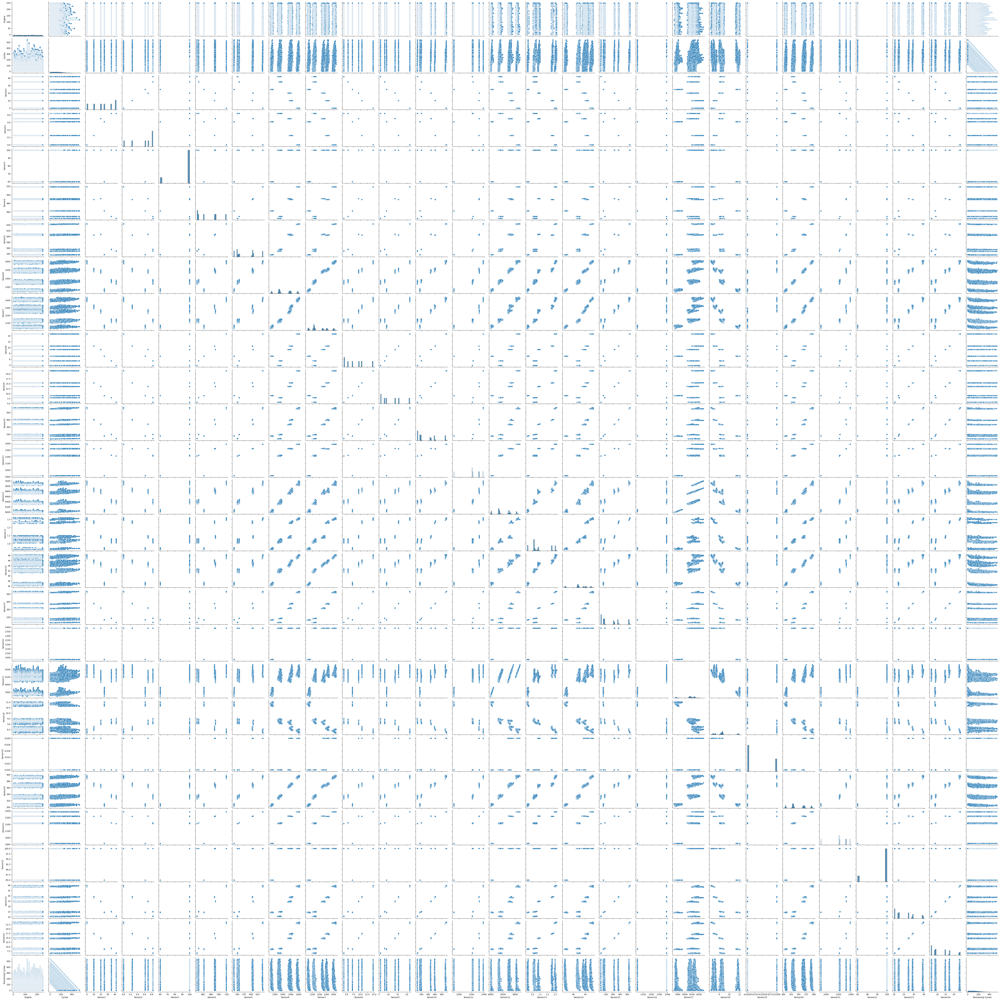

In [6]:
sns.pairplot(df)

<Axes: >

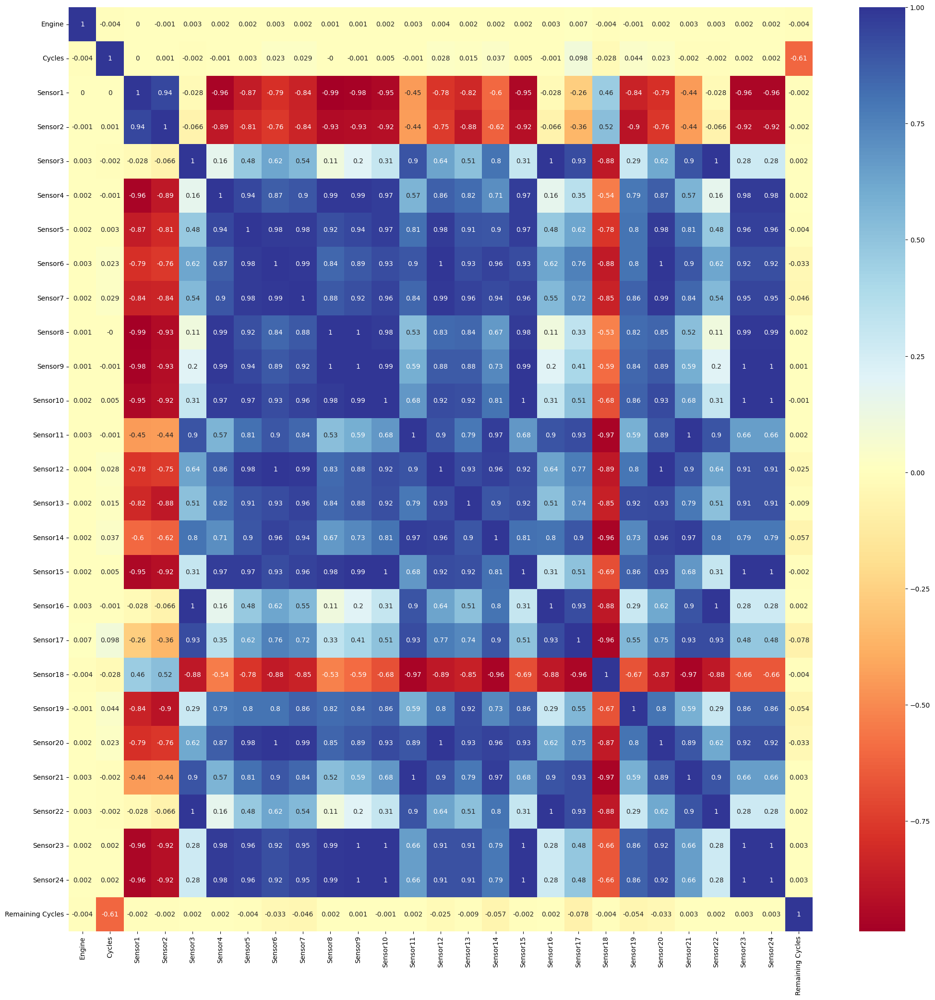

In [7]:
crm=df.corr().round(3)
fig=plt.figure(figsize=(25,25))
color = plt.get_cmap('RdYlBu')   # default color
color.set_bad('pink')  
sns.heatmap(crm,annot=True,cmap=color)

In [8]:
column=df.columns
column

Index(['Engine', 'Cycles', 'Sensor1', 'Sensor2', 'Sensor3', 'Sensor4',
       'Sensor5', 'Sensor6', 'Sensor7', 'Sensor8', 'Sensor9', 'Sensor10',
       'Sensor11', 'Sensor12', 'Sensor13', 'Sensor14', 'Sensor15', 'Sensor16',
       'Sensor17', 'Sensor18', 'Sensor19', 'Sensor20', 'Sensor21', 'Sensor22',
       'Sensor23', 'Sensor24', 'Remaining Cycles'],
      dtype='object')

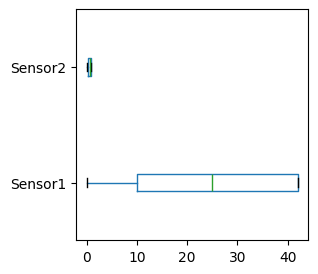

In [9]:
fig,ax=plt.subplots(figsize=(3,3))
k=2
df.iloc[:,2:4].boxplot(vert=False)
plt.grid(False)

In [10]:
import plotly.express as px

fig = px.parallel_coordinates(df.iloc[:,2:], color="Remaining Cycles",
                              color_continuous_scale=px.colors.diverging.delta_r,
                              color_continuous_midpoint=2,width=1200,height=1200,labels={'Sensor1':'S1', 'Sensor2':'S2', 'Sensor3':'S3', 'Sensor4':'S4',
       'Sensor5':'S5', 'Sensor6':'S6', 'Sensor7':'S7', 'Sensor8':'S8', 'Sensor9':'S9', 'Sensor10':'S10',
       'Sensor11':'S11', 'Sensor12':'S12', 'Sensor13':'S13', 'Sensor14':'S14', 'Sensor15':'S15', 'Sensor16':'S16',
       'Sensor17':'S17', 'Sensor18':'S18', 'Sensor19':'S19', 'Sensor20':'S20', 'Sensor21':'S21', 'Sensor22':'S22',
       'Sensor23':'S23', 'Sensor24':'S24', 'Remaining Cycles':'RC'})

fig.show()

<Axes: xlabel='Sensor1', ylabel='Remaining Cycles'>

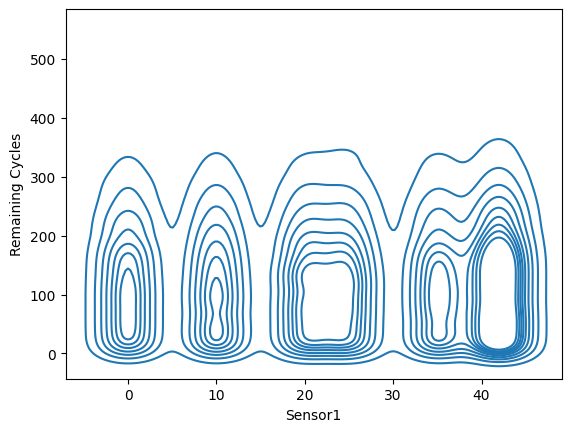

In [11]:
sns.kdeplot(df,x="Sensor1",y="Remaining Cycles")


In [12]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif_df=pd.DataFrame()
vif_df["feature"]=df.columns
vif_val=[]
for i in range(df.shape[1]):
    vif_val.append(variance_inflation_factor(df.values,i))
vif_df["VIF"]=vif_val
vif_df

,feature,VIF
0,Engine,1.002701e+00
1,Cycles,2.580753e+00
2,Sensor1,4.495905e+06
3,Sensor2,1.990775e+05
4,Sensor3,7.217423e+10
5,Sensor4,7.300873e+08
6,Sensor5,1.398111e+04
7,Sensor6,6.547636e+02
8,Sensor7,7.132713e+02
9,Sensor8,4.873537e+06
